# 2.43 Графика. Обзор Python и других инструментов. Часть 1


## Matplotlib
### Оптические эффекты
[3D Matplotlib](https://matplotlib.org/stable/gallery/misc/demo_agg_filter.html#sphx-glr-gallery-misc-demo-agg-filter-py)

In [1]:
#import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.transforms as mtransforms
from matplotlib.colors import LightSource
from matplotlib.artist import Artist
import numpy as np

def smooth1d(x, window_len):
    # https://scipy-cookbook.readthedocs.io/items/SignalSmooth.html
    s = np.r_[2*x[0]-x[window_len:1:-1],x,2*x[-1]-x[-1:-window_len:-1]]
    w = np.hanning(window_len)
    y = np.convolve(w/w.sum(),s,mode='same')
    return y[window_len-1:-window_len+1]

def smooth2d(A, sigma=3):
    window_len = max(int(sigma),3)*2+1
    A = np.apply_along_axis(smooth1d,0,A,window_len)
    A = np.apply_along_axis(smooth1d,1,A,window_len)
    return A

class BaseFilter:
    def get_pad(self, dpi):
        return 0
    def process_image(self, padded_src, dpi):
        raise NotImplementedError("should be overridden by subclasses")
    def __call__(self, im, dpi):
        pad = self.get_pad(dpi)
        padded_src = np.pad(im,[(pad,pad),(pad,pad),(0, 0)],"constant")
        tgt_image = self.process_image(padded_src,dpi)
        return tgt_image, -pad, -pad

class OffsetFilter(BaseFilter):
    def __init__(self, offsets=(0,0)):
        self.offsets = offsets
    def get_pad(self, dpi):
        return int(max(self.offsets)/72*dpi)
    def process_image(self, padded_src, dpi):
        ox, oy = self.offsets
        a1 = np.roll(padded_src,int(ox/72*dpi),axis=1)
        a2 = np.roll(a1,-int(oy/72*dpi),axis=0)
        return a2

class GaussianFilter(BaseFilter):
    def __init__(self, sigma, alpha=.5, color=(0,0,0)):
        self.sigma = sigma
        self.alpha = alpha
        self.color = color
    def get_pad(self, dpi):
        return int(self.sigma*3/72*dpi)
    def process_image(self, padded_src, dpi):
        tgt_image = np.empty_like(padded_src)
        tgt_image[:,:,:3] = self.color
        tgt_image[:,:,3] = smooth2d(
            padded_src[:,:,3]*self.alpha,self.sigma/72*dpi)
        return tgt_image

class DropShadowFilter(BaseFilter):
    def __init__(self, sigma, alpha=.3, color=(0,0,0), offsets=(0,0)):
        self.gauss_filter = GaussianFilter(sigma,alpha,color)
        self.offset_filter = OffsetFilter(offsets)
    def get_pad(self, dpi):
        return max(self.gauss_filter.get_pad(dpi),
                   self.offset_filter.get_pad(dpi))
    def process_image(self, padded_src, dpi):
        t1 = self.gauss_filter.process_image(padded_src,dpi)
        t2 = self.offset_filter.process_image(t1,dpi)
        return t2

class LightFilter(BaseFilter):
    def __init__(self, sigma, fraction=1):
        self.gauss_filter = GaussianFilter(sigma,alpha=1)
        self.light_source = LightSource()
        self.fraction = fraction
    def get_pad(self, dpi):
        return self.gauss_filter.get_pad(dpi)
    def process_image(self, padded_src, dpi):
        t1 = self.gauss_filter.process_image(padded_src, dpi)
        elevation = t1[:,:,3]
        rgb = padded_src[:,:,:3]
        alpha = padded_src[:,:,3:]
        rgb2 = self.light_source.shade_rgb(
            rgb,elevation,fraction=self.fraction,blend_mode="overlay")
        return np.concatenate([rgb2,alpha],-1)

class GrowFilter(BaseFilter):
    def __init__(self, pixels, color=(1,1,1)):
        self.pixels = pixels
        self.color = color
    def __call__(self, im, dpi):
        alpha = np.pad(im[...,3], self.pixels,"constant")
        alpha2 = np.clip(smooth2d(alpha, self.pixels/72*dpi)*5,0,1)
        new_im = np.empty((*alpha2.shape, 4))
        new_im[:,:,:3] = self.color
        new_im[:,:,3] = alpha2
        offsetx, offsety = -self.pixels, -self.pixels
        return new_im, offsetx, offsety

class FilteredArtistList(Artist):
    def __init__(self, artist_list, filter):
        super().__init__()
        self._artist_list = artist_list
        self._filter = filter
    def draw(self, renderer):
        renderer.start_rasterizing()
        renderer.start_filter()
        for a in self._artist_list:
            a.draw(renderer)
        renderer.stop_filter(self._filter)
        renderer.stop_rasterizing()

In [2]:
# np.pad?

In [3]:
def drop_shadow_line(ax):
    l1, = ax.plot([.1,.5,.9],[.1,.6,.5],c='#3636ff',marker='*')
    l2, = ax.plot([.1,.5,.9],[.3,.2,.7],c='#ff3636',marker='h')
    gauss = DropShadowFilter(5)
    for l in [l1, l2]:
        xx = l.get_xdata()
        yy = l.get_ydata()
        shadow, = ax.plot(xx,yy)
        shadow.update_from(l)
        transform = mtransforms.offset_copy(
            l.get_transform(),ax.figure,x=4.,y=-6.,units='points')
        shadow.set_transform(transform)
        shadow.set_zorder(l.get_zorder()-.5)
        shadow.set_agg_filter(gauss)
        shadow.set_rasterized(True)
    ax.set_xlim(0.,1.)
    ax.set_ylim(0.,1.)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)

def drop_shadow_patches(ax):
    N = 5
    c1,c2,ec='#3636ff','#ff3636','whitesmoke'
    group1 = [20,35,30,35,27]
    width = .35  
    rects1 = ax.bar(
        np.arange(N),group1,width,color=c1,ec=ec,lw=2)
    group2 = [25,32,34,20,25]
    rects2 = ax.bar(
        np.arange(N)+width+.1,group2,width,color=c2,ec=ec,lw=2)
    drop = DropShadowFilter(5,offsets=(1,1))
    shadow = FilteredArtistList(rects1+rects2,drop)
    ax.add_artist(shadow)
    shadow.set_zorder(rects1[0].get_zorder()-.1)
    ax.set_ylim(0,1.2*max(group1+group2))
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)

def light_filter_pie(ax):
    fracs = [15,30,45,10]
    explode = (.1,.2,.1,.1)
    colors = ['#ff3636','#36ff36','#3636ff','#ff36ff' ]
    pies = ax.pie(fracs,explode=explode,colors=colors)
    light_filter = LightFilter(9)
    for p in pies[0]:
        p.set_agg_filter(light_filter)
        p.set_rasterized(True)  
        p.set(ec='none',lw=2)
    gauss = DropShadowFilter(9,offsets=(3,-4),alpha=.7)
    shadow = FilteredArtistList(pies[0],gauss)
    ax.add_artist(shadow)
    shadow.set_zorder(pies[0][0].get_zorder()-.1)

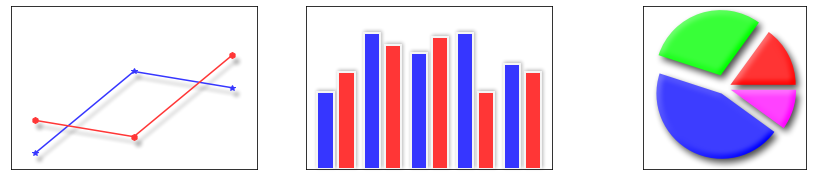

In [4]:
fix, axs = plt.subplots(1,3,figsize=(15,3))
drop_shadow_line(axs[0])
drop_shadow_patches(axs[1])
light_filter_pie(axs[2])
axs[2].set_frame_on(True);

### Математические функции и Latex

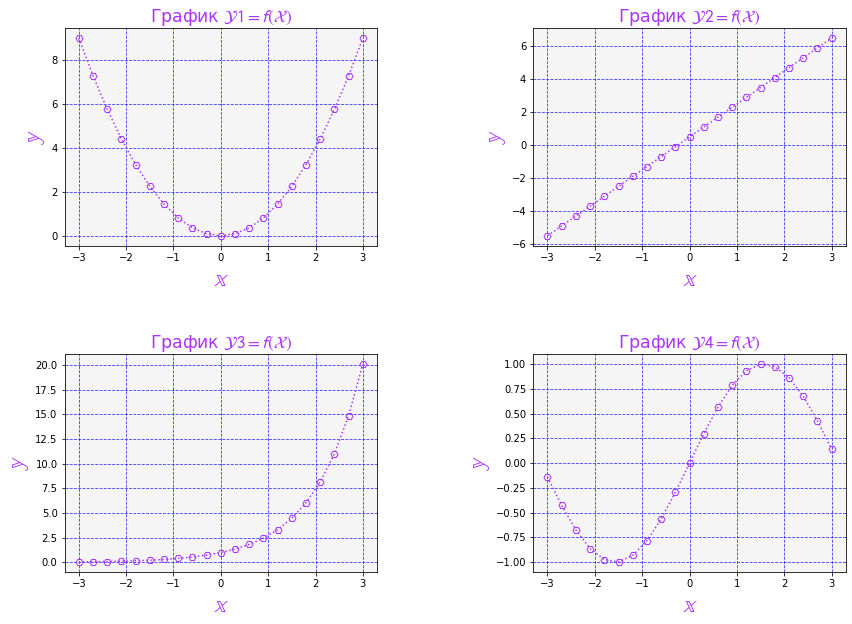

In [5]:
import matplotlib.pyplot as plt, numpy as np
X = np.linspace(-3, 3, 21)
Y1, Y2 = X ** 2, 2 * X + .5
Y3, Y4 = np.exp(X), np.sin(X)
fig, ax = plt.subplots(nrows=2, ncols=2)
n = 1
for a, Y in zip(ax.flat, [Y1, Y2, Y3, Y4]):
    a.plot(X, Y,'-H',color='#aa33ff', ms=7, ls=':', markerfacecolor='none')
    a.set_title("График $\mathcal{Y %d = f(X)}$"%n,color='#aa33ff',
                 fontdict={'fontsize':'xx-large'})
    a.set_xlabel('$\mathbb{x}$',fontsize=25,color='#aa33ff')
    a.set_ylabel('$\mathbb{y}$',fontsize=25,color='#aa33ff')
    a.grid(color='#3333ff',ls='--');  a.set_facecolor('whitesmoke') 
    n += 1
fig.set_size_inches(14, 10)
plt.subplots_adjust(wspace=.5, hspace=.5);

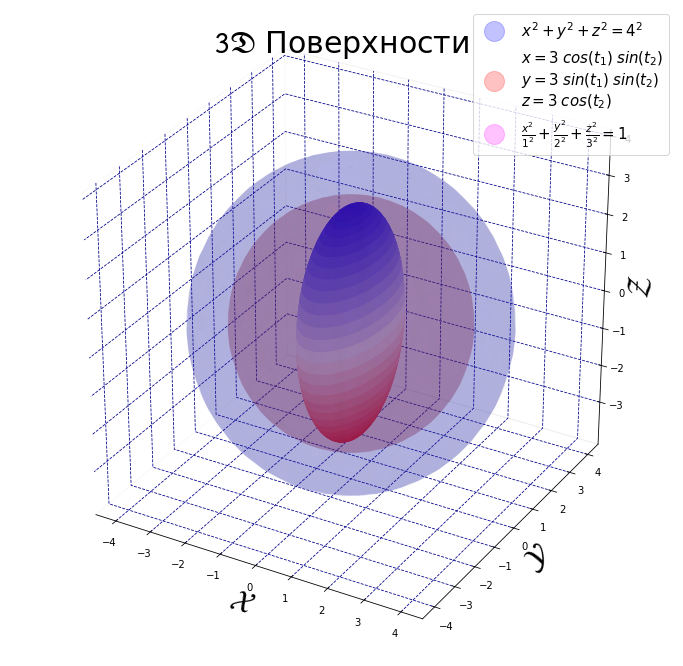

In [6]:
import numpy as np,pylab as pl
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.lines import Line2D
pl.rcParams['grid.color']='darkblue'
pl.rcParams['grid.linestyle']='--'
angle=np.linspace(0,2*np.pi,64)
T1,T2=np.meshgrid(angle,angle)
X=np.cos(T1)*np.sin(T2); Y=np.sin(T1)*np.sin(T2); Z=np.cos(T2)
labels=['$x^2+y^2+z^2=4^2$',
        '$x=3\;cos(t_1)\;sin(t_2)$\n'+\
        '$y=3\;sin(t_1)\;sin(t_2)$\n$z=3\;cos(t_2)$',
        '$\\frac{x^2}{1^2}+\\frac{y^2}{2^2}+\\frac{z^2}{3^2}=1$']
colors=['#3636ff','#ff3636','#ff36ff']
fig=pl.figure(figsize=(12,12))
ax=fig.add_subplot(111,projection='3d')
ax.plot_surface(4*X,4*Y,4*Z,color=colors[0],alpha=.1)
ax.plot_surface(3*X,3*Y,3*Z,color=colors[1],alpha=.1)
ax.plot_surface(1*X,2*Y,3*Z,cmap=pl.cm.bwr_r,linewidth=1,
                antialiased=True,rstride=1,cstride=1)
ax.set_xlabel('$\mathcal{X}$',fontsize=30)
ax.set_ylabel('$\mathcal{Y}$',fontsize=30)
ax.set_zlabel('$\mathcal{Z}$',fontsize=30)
fake2Dlines=[Line2D(
    [0],[0],linestyle='none',c=c,marker='o',ms=20,alpha=.3) for c in colors]
ax.legend(fake2Dlines,labels,loc=1,fontsize=15)
ax.xaxis.pane.fill,ax.yaxis.pane.fill,ax.zaxis.pane.fill=False,False,False
ax.set_title('$\mathfrak{3D}$ Поверхности',fontsize=30);

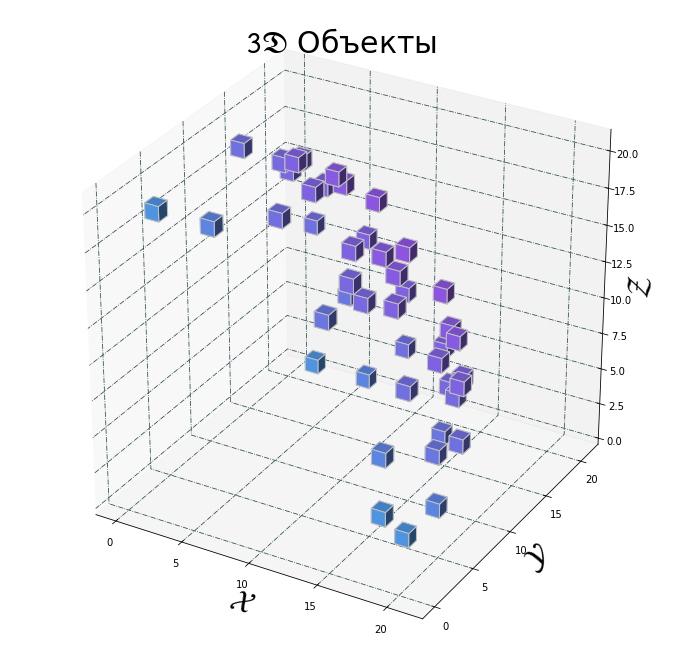

In [7]:
import numpy as np,pylab as pl
from mpl_toolkits.mplot3d import Axes3D
pl.rcParams['grid.color']='darkslategray'
pl.rcParams['grid.linestyle']='-.'
k=21; x,y,z=np.indices((k,k,k))
eq=(x-4)**2+(y-5)**2+(z-6)**2==225
f=pl.figure(figsize=(12,12))
ax=f.gca(projection='3d')
ax.voxels(
    eq,facecolors=pl.cm.cool((x+y+z)*4),edgecolor='silver')
ax.set_xlabel('$\mathcal{X}$',fontsize=30)
ax.set_ylabel('$\mathcal{Y}$',fontsize=30)
ax.set_zlabel('$\mathcal{Z}$',fontsize=30)
ax.set_title('$\mathfrak{3D}$ Объекты',fontsize=30);

### Детекция контуров объекта

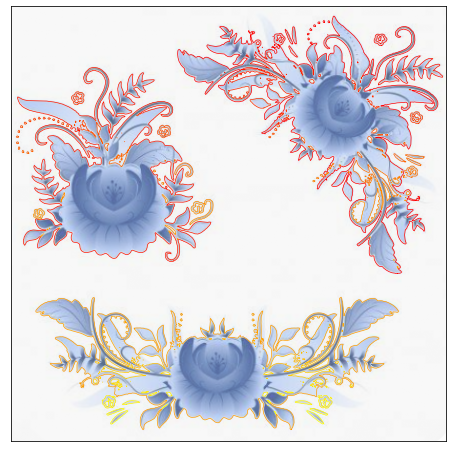

In [8]:
import pylab as pl
from skimage import io,color,measure
cmaps=['ocean','cool','gnuplot2','terrain',
       'winter','spring','summer','autumn']
file_path='https://raw.githubusercontent.com/'+\
          'OlgaBelitskaya/data/main/decors/'
file_name='00_00_005.png'
img=io.imread(file_path+file_name)
rgb_img=color.colorconv.rgba2rgb(img)
gray_img=color.colorconv.rgb2gray(rgb_img)
contours=measure.find_contours(gray_img,.85)
n=len(contours)
pl.figure(figsize=(8,8))
pl.gca().invert_yaxis()
[pl.plot(contours[i][:,1],contours[i][:,0],lw=.7,
 color=pl.get_cmap(cmaps[7])(i/n)) for i in range(n)]
pl.imshow(rgb_img,alpha=.7)
pl.xticks([]); pl.yticks([]); 

### Интерполяция и анимация

In [15]:
import ipywidgets as ipw, numpy as np
from IPython.display import display
import PIL,time
from io import BytesIO
h,w = 300,300
iw_img = ipw.Image()
display(iw_img)
g = 200*np.ones((h,w,3), dtype=np.uint8)
c = np.array([h//2,w//2], dtype=int)
for i in range(120,360):
    r,theta = i/3,i/2
    p = c+r*np.array([np.cos(theta),np.sin(theta)])
    (y,x) = p.astype(int)
    rgb = np.array([i-120, 0, 360-i], dtype=np.uint8)
    gray = np.array([255, 255, 255], dtype=np.uint8)
    g[y-2:y+3,x-2:x+3,:] = gray
    g[y:y+4,x:x+4,:] = rgb
    pil_img = PIL.Image.fromarray(g)
    with BytesIO() as BIO:
        pil_img.save(BIO, format='png')
        png = BIO.getvalue()
    iw_img.value = png
    time.sleep(.3)

Image(value=b'')

In [9]:
import warnings; warnings.filterwarnings('ignore')
import tensorflow as tf,numpy as np,pylab as pl
import urllib,PIL.Image,imageio
from IPython.display import Image
file_path='https://raw.githubusercontent.com/OlgaBelitskaya/data/main/'
def load_img(path_to_img):
    img=tf.io.read_file(path_to_img)
    img=tf.image.decode_image(img,channels=3)
    img=tf.image.convert_image_dtype(img,tf.float32)
    shape=tf.cast(tf.shape(img)[:-1],tf.float32)
    return img[tf.newaxis,:]
def preprocess_img(img,img_size):
    shape=tf.cast(tf.shape(img)[1:-1],tf.float32)
    new_shape=tf.cast(shape*img_size/min(shape),tf.int32)
    img=tf.image.resize(img,new_shape)
    img=tf.keras.preprocessing.image.smart_resize(
        np.squeeze(img),(img_size,img_size))
    return img[tf.newaxis,:]
def interpolate_hypersphere(v1,v2,steps):
    v1norm=np.linalg.norm(v1)
    v2norm=np.linalg.norm(v2)
    v2normalized=v2*(v1norm/v2norm)
    vectors=[]
    for step in range(steps):
        interpolated=v1+(v2normalized-v1)*step/(steps-int(1))
        interpolated_norm=np.linalg.norm(interpolated)
        interpolated_normalized=\
        interpolated*(v1norm/interpolated_norm)
        vectors.append(interpolated_normalized)
    return np.array(vectors)

In [10]:
original,style='02_00_001.png','01_00_001.png'
original_folder,style_folder='seasons/','paintings/'
original=tf.keras.utils.get_file(
    original,file_path+original_folder+original)
style=tf.keras.utils.get_file(
    style,file_path+style_folder+style)
original_img=load_img(original)
style_img=load_img(style)
prepro_original_img=preprocess_img(original_img,384)
prepro_style_img=preprocess_img(style_img,384)
steps=30
imgs=np.vstack(
    [interpolate_hypersphere(
         np.squeeze(prepro_original_img),
         np.squeeze(prepro_style_img),steps),
     interpolate_hypersphere(
         np.squeeze(prepro_style_img),
         np.squeeze(prepro_original_img),2*steps)])
file_name='pic.gif'
imgs=np.clip(imgs*255,1,254)
imgs=np.array(imgs,dtype=np.uint8)
imageio.mimsave(file_name,imgs)

752081/752081 [==============================] - 0s 0us/step


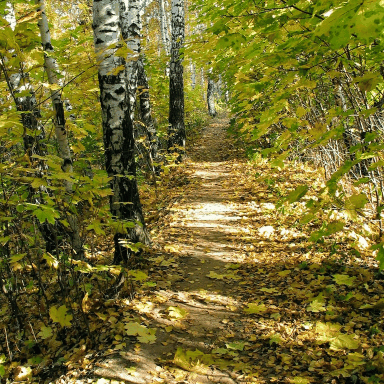

In [11]:
Image(open('pic.gif','rb').read())

## Plotly

In [12]:
def configure_plotly():
  from IPython.display import HTML,display
  import cufflinks as cf
  display(HTML("""
  <script src='/static/components/requirejs/require.js'></script>
  <script>requirejs.config(
      {paths:{base:'/static/base',
              plotly:'https://cdn.plot.ly/plotly-1.5.1.min.js?noext'}});
  </script>"""))
  cf.go_offline()

from plotly.offline import init_notebook_mode,iplot
import pandas as pd, plotly.graph_objs as go
configure_plotly()
init_notebook_mode(connected=False)

columns=['Fresh','Milk','Grocery','Frozen',
         'Detergents_Paper','Delicatessen']
colors=['#5a8bbd','#008b8b','#ff5a8b']
index= ['Customer 1','Customer 2','Customer 3']
data=[[26373,36423,22019,5154,4337,16523],
      [16165,4230,7595,201,4003,57],
      [14276,803,3045,485,100,518]]
df=pd.DataFrame(data,columns=columns,index=index) 
go1=[go.Bar(x=df.columns,y=df.iloc[i,:],name=df.index[i])
     for i in range(3)]
layout1=go.Layout(width=900,height=300,barmode='stack',
                  template='plotly_white')
iplot({'data':go1,'layout':layout1})

In [13]:
def configure_plotly():
  from IPython.display import HTML,display
  import cufflinks as cf
  display(HTML("""
  <script src='/static/components/requirejs/require.js'></script>
  <script>requirejs.config(
      {paths:{base:'/static/base',
              plotly:'https://cdn.plot.ly/plotly-1.5.1.min.js?noext'}});
  </script>"""))
  cf.go_offline()
from plotly.offline import init_notebook_mode,iplot
import numpy as np, plotly.graph_objs as go
configure_plotly()
a,b=np.random.randint(1,3),np.random.randint(3,5)
c,d=np.random.randint(2,4),np.random.randint(10,12)
e,f=np.random.randint(13,18),np.random.randint(1,3)
t=np.linspace(0,2*np.pi,60); r=[-1,0,1]
fx=-d*np.cos(t)-f*np.cos(b*t)+e*np.sin(a*t)
fy=-e*np.cos(a*t)+d*np.sin(t)-f*np.sin(b*t)
fz=d*np.cos(c*t)
go2=[go.Scatter3d(z=r[k]*fz,x=r[i]*fx,y=r[j]*fy,marker=dict(size=1.5)) 
     for i in range(3) for j in range(3) for k in range(3)]
scene=dict(xaxis=dict(title='',showticklabels=False),
           yaxis=dict(title='',showticklabels=False),
           zaxis=dict(title='',showticklabels=False))
layout2=go.Layout(title='3D Functions',autosize=False,
                  width=500,height=500,showlegend=False,
                  margin=dict(l=3,r=3,b=3,t=30),
                  scene=scene,template='plotly_dark')
iplot({'data':go2,'layout':layout2})

## HTML объекты

In [14]:
from IPython.display import display,HTML
width=1100; data=[4,12,21,38,42,63]
chart_title='Bar Charts'
def barh_chart(data,chart_title,width,
               font_size=20,
               font_family='Wallpoet',
               background_color='#ff355e'):
    dmax=max(data); wbar=round(width/100*dmax*1.1)
    html_str="""
    <style>
    @import 'https://fonts.googleapis.com/css?family="""+font_family+"""'; 
    .div_params {padding:5px; width:"""+str(wbar)+"""px; 
                 text-align:right; text-shadow:4px 4px 4px slategray; 
                 color:lightgray; font-size:"""+str(font_size)+"""px; 
                 font-family:"""+font_family+"""; 
                 background:linear-gradient(
                     180deg,  whitesmoke 0%, lightgray 25%, darkgrey 50%,
                     slategray 75%, darkslategray 100%);}
    .div_params_in {background:"""+background_color+"""; 
                    padding:10px; margin:3px;}
    .div_h1 {text-shadow:4px 4px 4px slategray; 
             color:"""+background_color+"""; 
             font-family:"""+font_family+""";}
    </style>
    <div class='div_params'>
    <h2 class='div_h1'>"""+chart_title+"""</h2>"""
    for i in range(len(data)):
        html_str+="""
        <div class='div_params_in' 
        style='width:"""+str(width/100*data[i])+"""px;
        '>"""+str(data[i])+"""</div>"""
    html_str+="""</div><br/>"""
    display(HTML(html_str))
barh_chart(data,chart_title,width)